In [ ]:
!pip install shap
!pip install dataprep
!pip install catboost

# Konten

1. baseline value - Baseline Fetal Heart Rate (FHR)
2. accelerations - Number of accelerations per second
3. fetal_movement - Number of fetal movements per second
4. uterine_contractions - Number of uterine contractions per second
5. light_decelerations - Number of LDs per second
6. severe_decelerations - Number of SDs per second
7. prolongued_decelerations - Number of PDs per second
8. abnormal_short_term_variability - Percentage of time with abnormal short term variability
9. mean_value_of_short_term_variability - Mean value of short term variability
10. percentage_of_time_with_abnormal_long_term_variability - Percentage of time with abnormal long term variability
11. mean_value_of_long_term_variability - Mean value of long term variability
12. histogram_width - Width of the histogram made using all values from a record
13. histogram_min - Histogram minimum value
14. histogram_max - Histogram maximum value
15. histogram_number_of_peaks - Number of peaks in the exam histogram
16. histogram_number_of_zeroes - Number of zeroes in the exam histogram
17. histogram_mode - Hist mode
18. histogram_mean - Hist mean
19. histogram_median - Hist Median
20. histogram_variance - Hist variance
21. histogram_tendency - Histogram trend
22. fetal_health - 1 - Normal 2 - Suspect 3 - Pathological

[Sumber data](https://www.kaggle.com/datasets/andrewmvd/fetal-health-classification)

## Tujuan
Membangun pemodelan ***Machine-learning*** untuk mengklasifikasi kesehatan janin

***DISCLAIMER***:
This material is for machine learning educational purposes only. This material should NOT be used for medical management of patients and is NOT a substitute for care by medical profesional



In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
from plotly.subplots import make_subplots

import ipywidgets as widgets

In [3]:
# Setting Visualization Default
pio.templates[pio.templates.default] = 'plotly_dark'
plt.rcParams['figure.figsize'] = [14, 9]
plt.rcParams.update({'font.size': 14})

In [4]:
path = "/content/drive/MyDrive/Fetal Health/fetal_health.csv"
main_df = pd.read_csv(path)

n_samples, n_features = main_df.shape
print(f'Number of samples: {n_samples}')
print(f'Number of features: {n_features}\n')

main_df.head()

Number of samples: 2126
Number of features: 22



,baseline value,accelerations,fetal_movement,uterine_contractions,light_decelerations,severe_decelerations,prolongued_decelerations,abnormal_short_term_variability,mean_value_of_short_term_variability,percentage_of_time_with_abnormal_long_term_variability,...,histogram_min,histogram_max,histogram_number_of_peaks,histogram_number_of_zeroes,histogram_mode,histogram_mean,histogram_median,histogram_variance,histogram_tendency,fetal_health
0,120.0,0.000,0.0,0.000,0.000,0.0,0.0,73.0,0.5,43.0,...,62.0,126.0,2.0,0.0,120.0,137.0,121.0,73.0,1.0,2.0
1,132.0,0.006,0.0,0.006,0.003,0.0,0.0,17.0,2.1,0.0,...,68.0,198.0,6.0,1.0,141.0,136.0,140.0,12.0,0.0,1.0
2,133.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.1,0.0,...,68.0,198.0,5.0,1.0,141.0,135.0,138.0,13.0,0.0,1.0
3,134.0,0.003,0.0,0.008,0.003,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,11.0,0.0,137.0,134.0,137.0,13.0,1.0,1.0
4,132.0,0.007,0.0,0.008,0.000,0.0,0.0,16.0,2.4,0.0,...,53.0,170.0,9.0,0.0,137.0,136.0,138.0,11.0,1.0,1.0



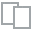
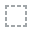
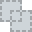
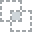
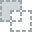
...
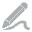
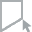
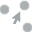
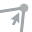
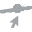

In [ ]:
from dataprep.eda import plot_missing

plot_missing(main_df)

Tidak terdapat nilai NaN pada dataset ini  🥰

sepertinya kita bisa pulang lebih cepat 🚀

Selanjutnya kita akan mengecek dan menghapus data duplikat

In [5]:
def remove_duplicate_row(df):
    duplicated_idx = df.duplicated()
    new_df = df[~duplicated_idx]
    print(f'Number of samples before removing duplicated row: {n_samples}')
    n_samples_after = new_df.shape[0]
    print(f'Number of samples after removing duplicated row: {n_samples_after}')
    return new_df

main_df = remove_duplicate_row(main_df)

Number of samples before removing duplicated row: 2126
Number of samples after removing duplicated row: 2113


## EDA
Pada tahapan selanjutnya kita akan mengobservasi distribusi data dan mengamati nilai statistik deskriptif pada fitur tersebut.

Fitur histogram tidak akan yang diobservasi.


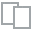
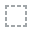
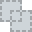
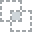
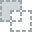
...
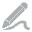
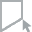
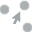
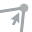
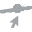

In [ ]:
from dataprep.eda import plot

plot(main_df, 'baseline value')

Dari Observasi ini fitur *baseline value* tidak perlu dilakukan *feature engineering* (data simetris dan *balanced* )


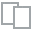
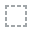
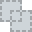
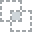
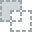
...
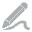
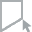
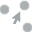
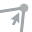
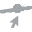

In [ ]:
plot(main_df, 'accelerations')


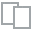
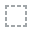
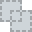
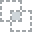
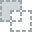
...
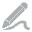
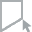
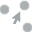
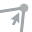
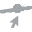

In [ ]:
plot(main_df, 'fetal_movement')


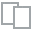
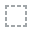
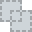
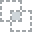
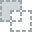
...
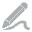
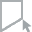
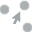
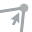
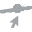

In [ ]:
plot(main_df, "uterine_contractions")


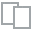
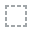
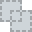
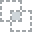
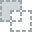
...
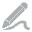
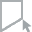
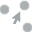
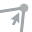
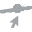

In [ ]:
plot(main_df, 'light_decelerations')


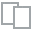
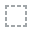
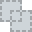
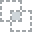
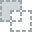
...
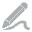
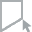
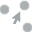
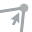
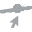

In [ ]:
plot(main_df, 'severe_decelerations')

Pada fitur ini meskipun nilai 0 terdapat sebanyak 99.7% perbedaan dengan nilai selanjutnya  yaitu 0.001 (1 dibanding 1000) dari nilai 0. Dengan kata lain fitur ini hampir dikatakan memiliki nilai yang sama.

*Note*: Meskipun nilai terlihat sangat kecil perbedaannya namun bisa jadi perbedaan 0.001 ini sangat dipertimbangkan dalam ilmu medis

Pada tahapan analisis fitur kita akan melihat apakah fitur ini diperlukan atau dapat dibuang


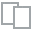
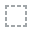
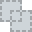
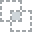
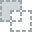
...
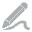
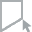
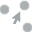
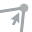
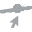

In [ ]:
plot(main_df, 'prolongued_decelerations')


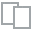
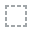
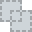
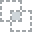
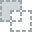
...
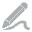
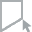
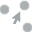
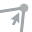
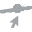

In [ ]:
plot(main_df, 'abnormal_short_term_variability')


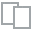
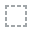
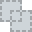
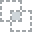
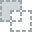
...
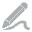
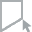
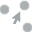
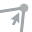
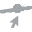

In [ ]:
plot(main_df, 'mean_value_of_short_term_variability')


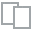
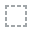
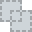
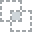
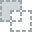
...
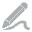
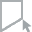
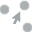
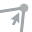
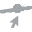

In [ ]:
plot(main_df, 'percentage_of_time_with_abnormal_long_term_variability')


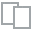
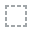
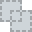
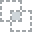
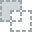
...
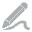
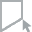
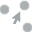
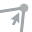
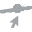

In [ ]:
plot(main_df, 'mean_value_of_long_term_variability')


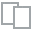
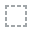
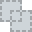
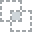
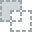
...
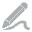
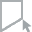
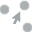
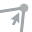
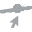

In [ ]:
plot(main_df, 'fetal_health')

Distribusi data pada fitur target yang ingin diprediksi sangat tidak *balanced*  perlu dilakukan oversampling atau undersampling pada proses selanjutnya


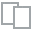
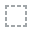
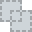
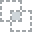
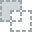
...
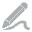
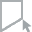
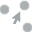
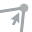
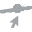

In [ ]:
from dataprep.eda import plot_correlation

plot_correlation(main_df)


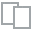
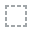
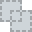
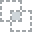
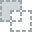
...
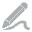
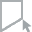
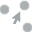
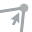
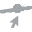

In [ ]:
plot_correlation(main_df, "fetal_health")

Terdapat 3 fitur yang berkolerasi dengan fitur fetal_health dengan nilai diatas 0.40 menggunakan metode *Pearson*. Fitur yang berkolerasi dengan *fetal_health* mengindikasikan peningkatan nilai pada fitur tersebut juga akan meningkatkan nilai pada *fetal_health*


## Balancing the Dataset
---
Pada tahapan ini terdapat 3 dataset baru yang akan dibuat dan dievaluasi untuk dipilih sebagai Dataset yang akan digunakan untuk pemodelan. Adapun 3 dataset tersebut adalah:

1. Dataset yang akan dibalanced dengan hanya menggunakan sample fetal health == 1 dan fetal health == 2 masing-masing sebanyak 175. Jumlah 175 merupakan jumlah sample pada fetal health == 3 (Target dengan jumlah sample terkecil)
2. Dataset yang dibalanced menggunakan teknik SMOTE
3. Dataset yang dibalanced menggunakan teknik ClusterCentroids

In [6]:
X = main_df.drop('fetal_health', axis=1)
y = main_df['fetal_health']

fetal_health_1 = main_df.index[main_df['fetal_health'] == 1].values.tolist()[:175]
fetal_health_2 = main_df.index[main_df['fetal_health'] == 2].values.tolist()[:175]
fetal_health_3 = main_df.index[main_df['fetal_health'] == 3].values.tolist()[:175]
all_idx = fetal_health_1 + fetal_health_2 +  fetal_health_3

X_balanced = X.loc[all_idx, :].reset_index(drop=True)
y_balanced = y[all_idx].reset_index(drop=True)
print(len(X_balanced))
print(len(y_balanced))

525
525


In [7]:
from imblearn.over_sampling import SMOTE
from collections import Counter

X_smote_resampled, y_smote_resampled = SMOTE().fit_resample(X, y)
print(sorted(Counter(y_smote_resampled).items()))

[(1.0, 1646), (2.0, 1646), (3.0, 1646)]


In [8]:
from imblearn.under_sampling import ClusterCentroids

cc = ClusterCentroids(random_state=0)
X_cc_resampled, y_cc_resampled = cc.fit_resample(X, y)
print(sorted(Counter(y_cc_resampled).items()))

[(1.0, 175), (2.0, 175), (3.0, 175)]


In [24]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.4, shuffle=True, random_state=42
)

In [10]:
from sklearn.linear_model import LogisticRegression

for name, X_, y_ in zip(
      ['Balanced', 'SMOTE Resampled', 'ClusterCentroids Resampled', 'Unblanced'],
      [X_balanced, X_smote_resampled, X_cc_resampled, X_train],
      [y_balanced, y_smote_resampled, y_cc_resampled, y_train]):
    reg = LogisticRegression(max_iter=1e5)
    reg.fit(X_, y_)
    test_set_score = reg.score(X_test, y_test)
    full_set_score = reg.score(X, y)
    print(f'Evaluating Accuracy in Model trained using {name} Dataset:')
    print(f'Accuracy score in Test set: {test_set_score:.4f}')
    print(f'Accuracy score in Full dataset: {full_set_score:.4f}')
    print('-' * 100)


Evaluating Accuracy in Model trained using Balanced Dataset:
Accuracy score in Test set: 0.7139
Accuracy score in Full dataset: 0.7189
----------------------------------------------------------------------------------------------------
Evaluating Accuracy in Model trained using SMOTE Resampled Dataset:
Accuracy score in Test set: 0.8475
Accuracy score in Full dataset: 0.8415
----------------------------------------------------------------------------------------------------
Evaluating Accuracy in Model trained using ClusterCentroids Resampled Dataset:
Accuracy score in Test set: 0.8168
Accuracy score in Full dataset: 0.8093
----------------------------------------------------------------------------------------------------
Evaluating Accuracy in Model trained using Unblanced Dataset:
Accuracy score in Test set: 0.8853
Accuracy score in Full dataset: 0.8864
----------------------------------------------------------------------------------------------------


Clearly, ***Unbalanced Dataset*** memenangkan perlombaan akurasi

Dataset ini selanjutnya akan digunakan untuk *training* pemodelan selanjutnya

In [ ]:
from scipy.stats import yeojohnson

all_feats = X_train.columns.values.tolist()
X_train_normalize = X_train.copy()
X_test_normalize = X_test.copy()

for col in all_feats:
    skewness = X_train_normalize[col].skew()
    if skewness >= 0.75:
        print(f'Skew value in {col}: {skewness:.4f}')
        X_train_normalize[col] = yeojohnson(X_train_normalize[col])[0]
        X_test_normalize[col] = yeojohnson(X_test_normalize[col])[0]
        skewness = X_train_normalize[col].skew()
        print(f'Skew value after YeoJohnson Transformation: {skewness:.4f}')
        print('-' * 40)
  

Skew value in accelerations: 1.1744
Skew value after YeoJohnson Transformation: 0.3794
----------------------------------------
Skew value in fetal_movement: 7.2641
Skew value after YeoJohnson Transformation: 1.9341
----------------------------------------
Skew value in light_decelerations: 1.7507
Skew value after YeoJohnson Transformation: 0.7006
----------------------------------------
Skew value in severe_decelerations: 15.8933
Skew value after YeoJohnson Transformation: 0.0000
----------------------------------------
Skew value in prolongued_decelerations: 4.1779
Skew value after YeoJohnson Transformation: 2.9506
----------------------------------------
Skew value in mean_value_of_short_term_variability: 1.6761
Skew value after YeoJohnson Transformation: 0.0340
----------------------------------------
Skew value in percentage_of_time_with_abnormal_long_term_variability: 2.2968
Skew value after YeoJohnson Transformation: 0.5170
----------------------------------------
Skew value in 

In [ ]:
reg = LogisticRegression(max_iter=1e5)
reg.fit(X_train_normalize, y_train)
score = reg.score(X_test_normalize, y_test)
print(score)

0.881316098707403


Dataset yang telah dinormalisasi tidak memberikan dampak signifikan pada akurasi, Hal ini sangat wajar karena banyak pemodelan klasifikasi salah satunya adalah LogisticRegression tidak terlalu sensitif terhadap distribusi data. Oleh karenannya kita masih akan tetap menggunakan data sebelumnya.

Penggunaan data semula juga akan memudahkan evaluasi fitur pada tahapan selanjutnya

In [11]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

from xgboost import XGBClassifier

In [25]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler().fit(X_train)
X = pd.DataFrame(sc.transform(X))
X_train = pd.DataFrame(sc.transform(X_train))
X_test = pd.DataFrame(sc.transform(X_test))

X.columns = main_df.drop('fetal_health', axis=1).columns.values.tolist()
X_train.columns = main_df.drop('fetal_health', axis=1).columns.values.tolist()
X_test.columns = main_df.drop('fetal_health', axis=1).columns.values.tolist()

In [48]:
from sklearn.preprocessing import label_binarize

y_train_binarize = label_binarize(y_train, classes=[1, 2, 3])
y_test_binarize = label_binarize(y_test, classes=[1, 2, 3])

In [27]:
import pickle

path = "/content/drive/MyDrive/fetal_sc.pkl"
pickle.dump(sc, open(path, 'wb'))

In [28]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.multiclass import OneVsRestClassifier

def my_pipeline(model, param_grid, n_iter=10):
    clf_grid = RandomizedSearchCV(
        model,
        param_distributions = param_grid,
        n_iter = n_iter,
        cv = 5,
        scoring='accuracy',
        random_state = 42
    )

    clf_grid.fit(X_train, y_train)
    best_params = clf_grid.best_params_

    test_set_score = clf_grid.score(X_test, y_test)
    full_set_score = clf_grid.score(X, y)
    model_name = type(model).__name__
    print(f'Evaluating {model_name} with Best Parameter:')
    print(f'{best_params}')
    print('-' * 100)
    print(f'Best Accuracy score in test set: {test_set_score:.4f}')
    print(f'Best Accuracy score in full set: {full_set_score:.4f}')

    model = model.set_params(**best_params)
    clf = OneVsRestClassifier(model.set_params(**best_params))
    clf.fit(X_train, y_train_binarize)

    return clf

In [29]:
# LogisticRegression
from sklearn.multiclass import OneVsRestClassifier
from sklearn.linear_model import LogisticRegression

param_distributions = {
    'C': [1e-3, 1e-2, 1, 10, 100, 1000]
}

model = LogisticRegression(max_iter=1e4)
log_reg = my_pipeline(model, param_distributions, n_iter=6)

Evaluating LogisticRegression with Best Parameter:
{'C': 1}
----------------------------------------------------------------------------------------------------
Best Accuracy score in test set: 0.9078
Best Accuracy score in full set: 0.9049


In [30]:
# DecisionTreeClassifier
from sklearn.tree import DecisionTreeClassifier

param_distributions = {
    'max_depth': np.arange(5, 16, 2),
    'min_samples_leaf': [1, 4,  8],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_leaf_nodes': np.arange(20, 100, 10)}

model = DecisionTreeClassifier()
decision_tree_clf = my_pipeline(model, param_distributions, n_iter=15)

Evaluating DecisionTreeClassifier with Best Parameter:
{'min_samples_leaf': 1, 'max_leaf_nodes': 50, 'max_features': 'auto', 'max_depth': 9}
----------------------------------------------------------------------------------------------------
Best Accuracy score in test set: 0.9196
Best Accuracy score in full set: 0.9380


In [31]:
# RandomForestClassifier
from sklearn.ensemble import RandomForestClassifier

param_distributions = {
    'n_estimators': [100, 200, 500],
    'max_depth': np.arange(5, 16, 2),
    'min_samples_leaf': [1, 4,  8],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_leaf_nodes': np.arange(20, 100, 10)}

model = RandomForestClassifier()
random_forest_clf = my_pipeline(model, param_distributions, n_iter=15)

Evaluating RandomForestClassifier with Best Parameter:
{'n_estimators': 200, 'min_samples_leaf': 1, 'max_leaf_nodes': 70, 'max_features': 'auto', 'max_depth': 9}
----------------------------------------------------------------------------------------------------
Best Accuracy score in test set: 0.9480
Best Accuracy score in full set: 0.9740


In [32]:
# XGBClassifier
from xgboost import XGBClassifier

param_distributions = {
    'n_estimators': [100, 250, 500],
    'max_depth': np.arange(5, 16, 2),   
    'eta':  np.linspace(0.1, 1.0, 10)}

model = XGBClassifier()
xgb_clf = my_pipeline(model, param_distributions, n_iter=15)

Evaluating XGBClassifier with Best Parameter:
{'n_estimators': 500, 'max_depth': 7, 'eta': 0.7000000000000001}
----------------------------------------------------------------------------------------------------
Best Accuracy score in test set: 0.9504
Best Accuracy score in full set: 0.9796


In [33]:
import pickle

path = "/content/drive/MyDrive/xgb_fetal.pkl"
pickle.dump(xgb_clf, open(path,'wb'))

In [34]:
# SVC
from sklearn.svm import SVC

param_distributions = {
    'C': [1e-3, 1e-3, 1.0, 10.0, 100.0, 1000.0],
}

model = SVC(tol=1e-6)
svc = my_pipeline(model, param_distributions, n_iter=6)

Evaluating SVC with Best Parameter:
{'C': 100.0}
----------------------------------------------------------------------------------------------------
Best Accuracy score in test set: 0.9362
Best Accuracy score in full set: 0.9673


In [35]:
# KNN
from sklearn.neighbors import KNeighborsClassifier

param_distributions = {
    'n_neighbors': [5, 10, 15, 20, 25],
    'weights': ['uniform', 'distance'],
    'p': [1, 2, 3, 4],
}

model = KNeighborsClassifier()
knn = my_pipeline(model, param_distributions)

Evaluating KNeighborsClassifier with Best Parameter:
{'weights': 'distance', 'p': 4, 'n_neighbors': 10}
----------------------------------------------------------------------------------------------------
Best Accuracy score in test set: 0.9113
Best Accuracy score in full set: 0.9640


In [36]:
# NaiveBayes
from sklearn.naive_bayes import GaussianNB

param_distributions = {
    'var_smoothing': np.logspace(0,-9, num=100)
}

model = GaussianNB()
gnb = my_pipeline(model, param_distributions, n_iter=15)

Evaluating GaussianNB with Best Parameter:
{'var_smoothing': 1.0}
----------------------------------------------------------------------------------------------------
Best Accuracy score in test set: 0.8605
Best Accuracy score in full set: 0.8391


In [37]:
# CatBoostClassifier
from catboost import CatBoostClassifier

param_distributions = {
    'depth':[3,1,2,6,4,5,7,8,9,10],
    'iterations':[250,100,500,1000],
    'learning_rate':[0.03,0.001,0.01,0.1,0.2,0.3], 
    'l2_leaf_reg':[3,1,5,10,100],
    'border_count':[32,5,10,20,50,100,200],}

model = CatBoostClassifier(verbose=False)
catboost_clf = my_pipeline(model, param_distributions, n_iter=20)

Evaluating CatBoostClassifier with Best Parameter:
{'learning_rate': 0.2, 'l2_leaf_reg': 1, 'iterations': 500, 'depth': 3, 'border_count': 200}
----------------------------------------------------------------------------------------------------
Best Accuracy score in test set: 0.9598
Best Accuracy score in full set: 0.9834


In [ ]:
path = "/content/drive/MyDrive/fetal_catboost.pkl"
pickle.dump(catboost_clf, open(path, 'wb'))

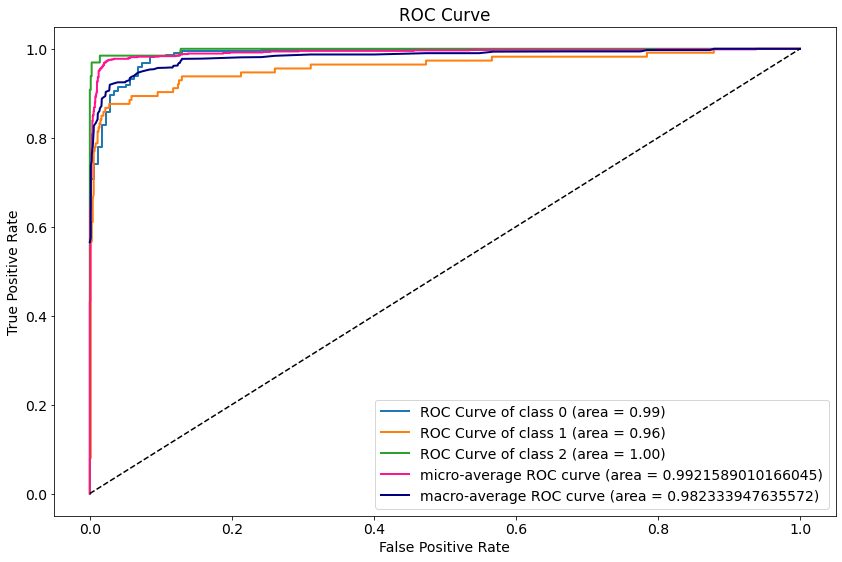

In [53]:
from sklearn.metrics import roc_curve, auc

n_classes = y_train.nunique()
y_score = catboost_clf.predict_proba(X_test)

fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test_binarize[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr['micro'], tpr['micro'], _ =  roc_curve(y_test_binarize.ravel(), y_score.ravel())
roc_auc['micro'] = auc(fpr['micro'], tpr['micro'])

all_fpr = np.unique(np.concatenate([fpr[i] for i in range(3)]))
mean_tpr = np.zeros_like(all_fpr)
for i in range(n_classes):
    mean_tpr += np.interp(all_fpr, fpr[i], tpr[i])

mean_tpr /= n_classes

fpr['macro'] = all_fpr
tpr['macro'] = mean_tpr
roc_auc['macro'] = auc(fpr['macro'], tpr['macro'])

fig, ax = plt.subplots()
for i in range(n_classes):
    ax.plot(
        fpr[i],
        tpr[i],
        label = f'ROC Curve of class {i} (area = {roc_auc[i]:.2f})',
        lw = 2
    )

ax.plot(
    fpr['micro'],
    tpr['micro'],
    label = f'micro-average ROC curve (area = {roc_auc["micro"]})',
    lw = 2,
    color = 'deeppink'
)

ax.plot(
    fpr['macro'],
    tpr['macro'],
    label = f'macro-average ROC curve (area = {roc_auc["macro"]})',
    lw = 2,
    color = 'navy'
)

ax.plot([0, 1], [0, 1], ls='--', color='k', lw=1.5)
ax.set_xlabel('False Positive Rate')
ax.set_ylabel('True Positive Rate')
ax.set_title('ROC Curve')

plt.legend()
plt.show()

In [54]:
def create_table(clf_report_df):
    cols = clf_report_df.columns.values.tolist()
    index_name = clf_report_df.index.name = ''
    index_val = clf_report_df.index = ['1', '2', '3', 'Acc', 'MacroAvg', 'WeightedAvg']
    precisions = clf_report_df['precision']
    recalls = clf_report_df['recall']
    f1_scores = clf_report_df['f1-score']
    supports = clf_report_df['support']

    trace = go.Table(
    header = {
        'height': 50,
        'values': [index_name] + cols,
        'fill_color': 'paleturquoise',
        'align': 'left',
        'font': dict(color='black', size=12)
    },
    cells=dict(
        values = [index_val, precisions, recalls, f1_scores, supports],
        fill_color = 'lavender',
        align = 'left',
        font = dict(color='black', size=12)
      )
    )

    return trace

In [93]:
from sklearn.metrics import accuracy_score, roc_curve, auc
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

y_pred = catboost_clf.predict(X_test)
y_pred = np.argmax(y_pred, axis=1) + 1
acc_test_set = accuracy_score(y_test, y_pred)

print()
print(f'{type(catboost_clf).__name__}')
print(f'Accuracy in test set: {acc_test_set:.3f}')
print('-' * 50)

fig = make_subplots(
    rows=2, cols=1,
    specs=[[{"type": "table",}],
           [{"type": "xy"}]],
    subplot_titles = ['Classification Report', 'Confusion Matrix'])

clf_report = classification_report(y_test, y_pred, output_dict=True)
clf_report = np.round(pd.DataFrame(clf_report).T, 2)
table = create_table(clf_report)
fig.add_trace(table, row=1, col=1)

z = confusion_matrix(y_test, y_pred)
z_text = [[str(y) for y in x] for x in z]
fig.add_trace(go.Heatmap(
    z = z, x = ['1', '2', '3'], y = ['1', '2', '3'], 
    text = z_text,
    texttemplate = "%{text}",
    textfont = {"size":20},
    showscale = False),
    row=2, col=1)

fig.update_xaxes(title='Predicted Value', row=2, col=1)
fig.update_yaxes(title='Real Value', row=2, col=1)

fig.update_layout(
    width = 800,
    height = 700,)

fig.show()


OneVsRestClassifier
Accuracy in test set: 0.961
--------------------------------------------------


Pada visualisasi konsep Confusion Matrix hal yang terpenting perlu diperhatikan adalah kesalahan prediksi 1 yang seharusnya diprediksi  3. Terdapat sebanyak 3 sample yang seharusnya didiagnosis kesehatan janin  adalah *Pathological*. Dalam dunia medis mendiagnosis pasien dalam keadaan sehat (meskipun sebenarnya tidak sehat) dapat berakibat fatal.

In [ ]:
# Model Explainability

params = {'learning_rate': 0.2, 'l2_leaf_reg': 1, 'iterations': 500, 'depth': 3, 'border_count': 200}
catboost_clf = CatBoostClassifier(**params)
catboost_clf.fit(X_train, y_train)

import shap
explainer = shap.TreeExplainer(catboost_clf)
shap_values = explainer.shap_values(X_test)

shap.summary_plot(shap_values, X_test)

Dari sini kita dapat menyimpulkan bahwa semakin kecil nilai pada seluruh 21 fitur akan memperkecil resiko janin tidak sehat. 